In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

import seaborn as sns
plt.style.use('ggplot')

In [2]:
import pandas_profiling

In [3]:
data = pd.read_csv('datasets/Absenteeism_at_work.csv')

In [4]:
data2 = pd.read_csv('datasets/Absenteeism_at_work.csv')

In [5]:
data2.groupby(['Reason for absence'])['Absenteeism time in hours'].mean().sort_values()

Reason for absence
0      0.000000
16     2.000000
27     2.275362
23     2.845638
28     2.991071
25     3.483871
4      4.500000
8      5.333333
21     5.833333
5      6.333333
26     7.272727
22     7.710526
24     8.000000
15     8.000000
17     8.000000
3      8.000000
14     8.789474
7     10.000000
18    10.333333
10    11.040000
1     11.375000
11    11.423077
13    15.309091
19    18.225000
6     21.375000
12    23.375000
2     24.000000
9     42.000000
Name: Absenteeism time in hours, dtype: float64

In [6]:
data.head()

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,11,26,7,3,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,4
1,36,0,7,3,1,118,13,18,50,239.554,...,1,1,1,1,0,0,98,178,31,0
2,3,23,7,4,1,179,51,18,38,239.554,...,0,1,0,1,0,0,89,170,31,2
3,7,7,7,5,1,279,5,14,39,239.554,...,0,1,2,1,1,0,68,168,24,4
4,11,23,7,5,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,2


In [7]:
data.isnull().sum()

ID                                 0
Reason for absence                 0
Month of absence                   0
Day of the week                    0
Seasons                            0
Transportation expense             0
Distance from Residence to Work    0
Service time                       0
Age                                0
Work load Average/day              0
Hit target                         0
Disciplinary failure               0
Education                          0
Son                                0
Social drinker                     0
Social smoker                      0
Pet                                0
Weight                             0
Height                             0
Body mass index                    0
Absenteeism time in hours          0
dtype: int64

In [8]:
data.ID

0      11
1      36
2       3
3       7
4      11
       ..
735    11
736     1
737     4
738     8
739    35
Name: ID, Length: 740, dtype: int64

In [9]:
sum(data.duplicated())

34

In [10]:
data = data[~data.duplicated()]

In [11]:
pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

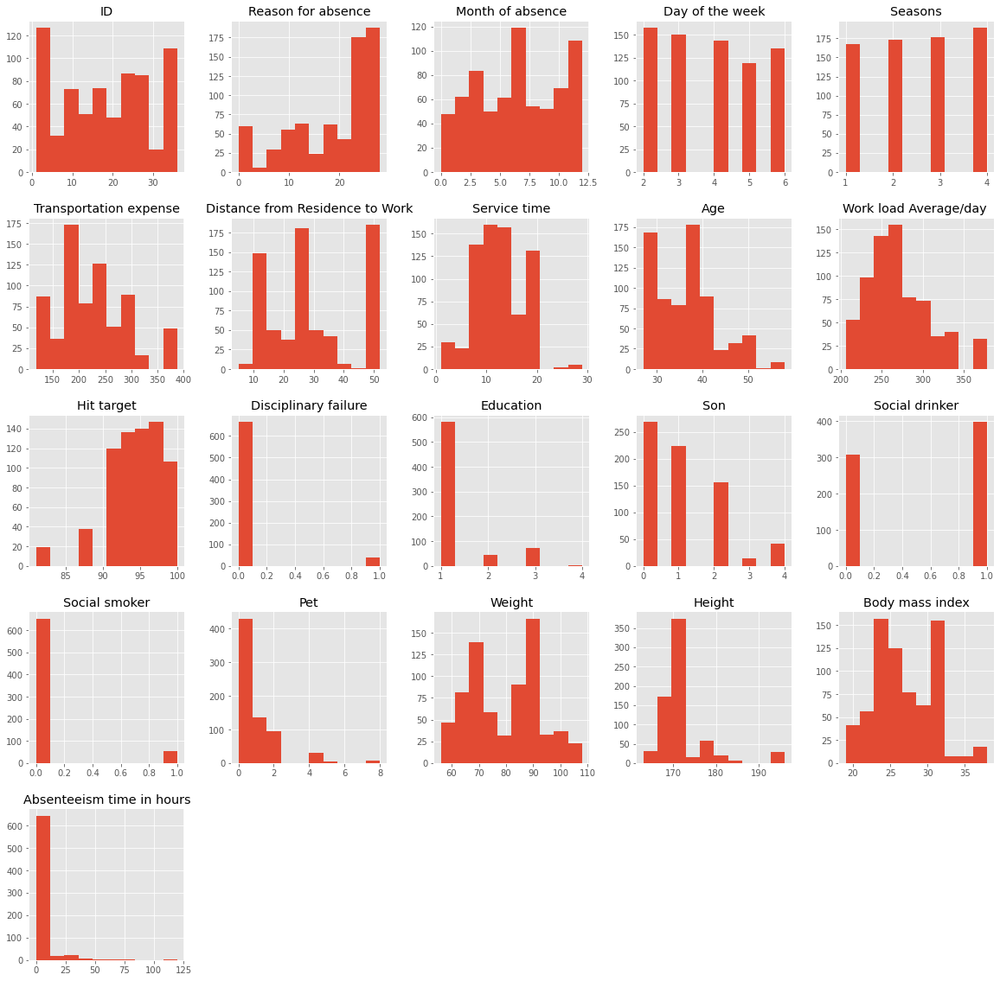

In [12]:
data.hist(figsize=(20, 20));

In [13]:
data.columns

Index(['ID', 'Reason for absence', 'Month of absence', 'Day of the week',
       'Seasons', 'Transportation expense', 'Distance from Residence to Work',
       'Service time', 'Age', 'Work load Average/day ', 'Hit target',
       'Disciplinary failure', 'Education', 'Son', 'Social drinker',
       'Social smoker', 'Pet', 'Weight', 'Height', 'Body mass index',
       'Absenteeism time in hours'],
      dtype='object')

In [14]:
data.drop(['ID'], axis=1, inplace=True)

In [15]:
target = ['Absenteeism time in hours']
numerical = [
    'Age',
    'Body mass index',
    'Distance from Residence to Work',
    'Height',
    'Hit target',
    'Service time',
    'Transportation expense',
    'Weight',
    'Work load Average/day '
]
categorical = [col for col in data.columns if col not in numerical + target]

In [16]:
numerical

['Age',
 'Body mass index',
 'Distance from Residence to Work',
 'Height',
 'Hit target',
 'Service time',
 'Transportation expense',
 'Weight',
 'Work load Average/day ']

In [17]:
categorical

['Reason for absence',
 'Month of absence',
 'Day of the week',
 'Seasons',
 'Disciplinary failure',
 'Education',
 'Son',
 'Social drinker',
 'Social smoker',
 'Pet']

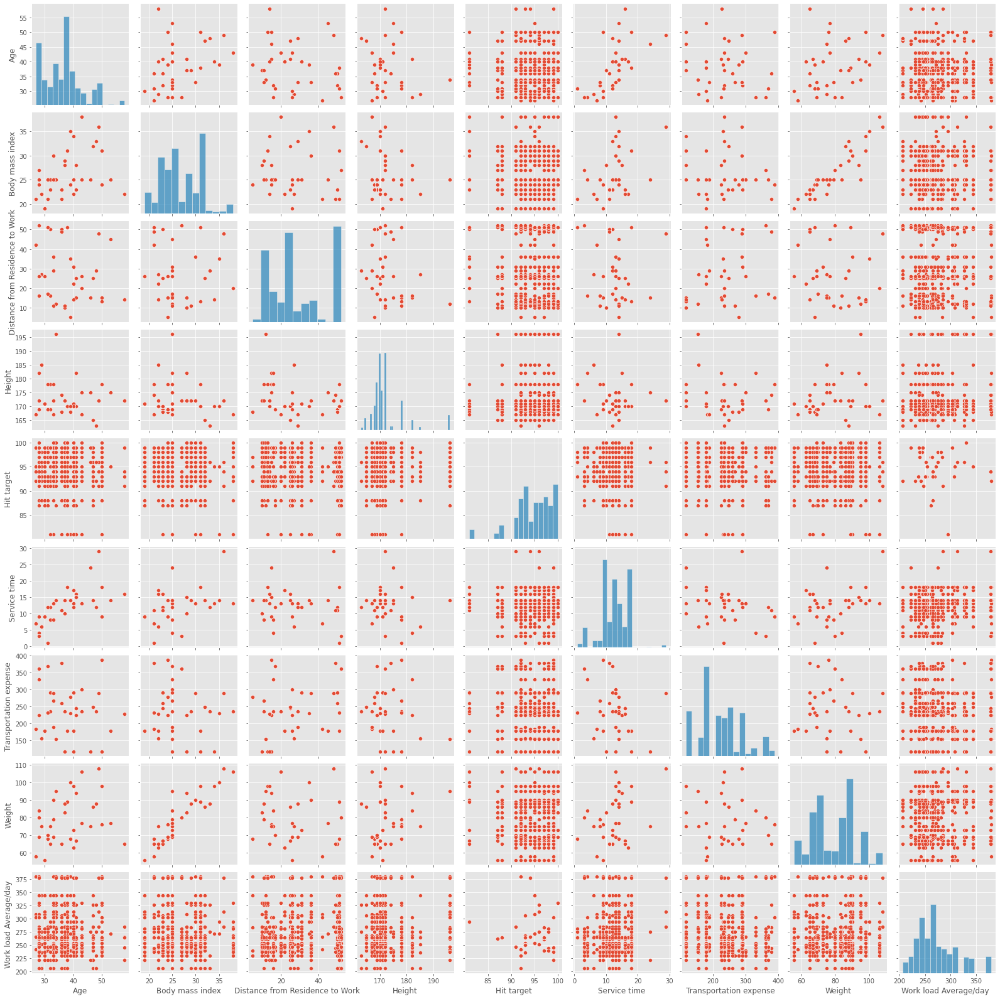

In [18]:
sns.pairplot(data[numerical]);

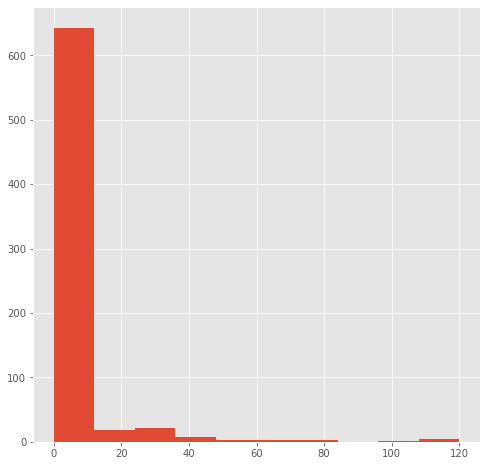

In [19]:
plt.figure(figsize=(8, 8))
data['Absenteeism time in hours'].hist();

In [20]:
data['Absenteeism time in hours'].head()

0    4
1    0
2    2
3    4
4    2
Name: Absenteeism time in hours, dtype: int64

<AxesSubplot:>

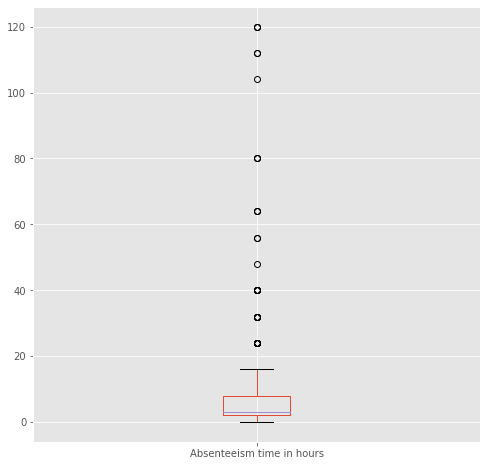

In [21]:
plt.figure(figsize=(8, 8))
data['Absenteeism time in hours'].plot.box()

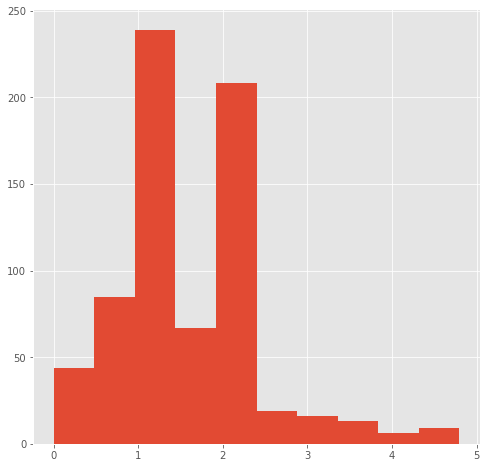

In [22]:
plt.figure(figsize=(8, 8))
(data['Absenteeism time in hours']+1).apply(np.log).hist();

# Убираем выбросы целевой переменной

In [23]:
data[data['Absenteeism time in hours'] <= 60].shape

(694, 20)

In [24]:
data.shape

(706, 20)

In [25]:
694/706 # Потеряли всего 2% наблюдений, это хорошо

0.9830028328611898

In [26]:
data = data[data['Absenteeism time in hours'] <= 60]

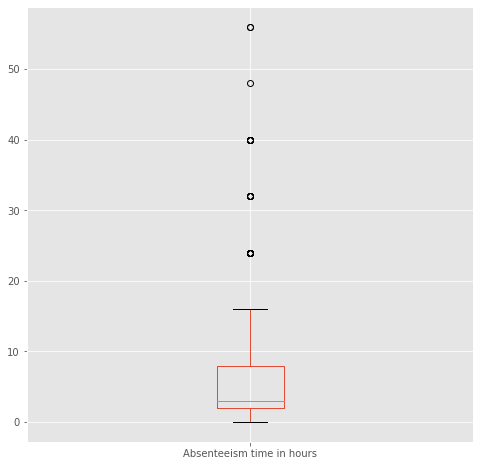

In [27]:
plt.figure(figsize=(8, 8))
data['Absenteeism time in hours'].plot.box();

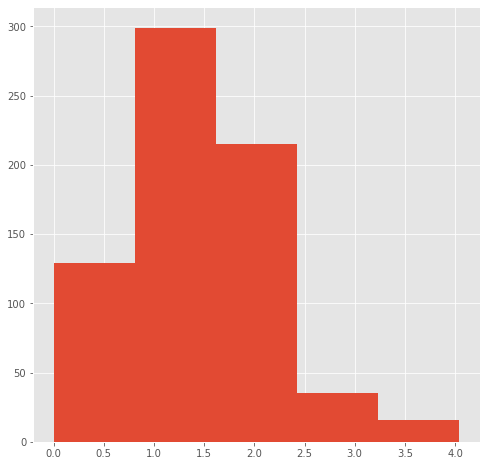

In [28]:
plt.figure(figsize=(8, 8))
(data['Absenteeism time in hours']+1).apply(np.log).hist(bins=5);

Берем значение отлогарифмированной переменной в качестве основного

In [29]:
data['Absenteeism time in hours'] = (data['Absenteeism time in hours']+1).apply(np.log)

## Категориальные переменные

In [30]:
data[categorical].head()

,Reason for absence,Month of absence,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,26,7,3,1,0,1,2,1,0,1
1,0,7,3,1,1,1,1,1,0,0
2,23,7,4,1,0,1,0,1,0,0
3,7,7,5,1,0,1,2,1,1,0
4,23,7,5,1,0,1,2,1,0,1


<AxesSubplot:>

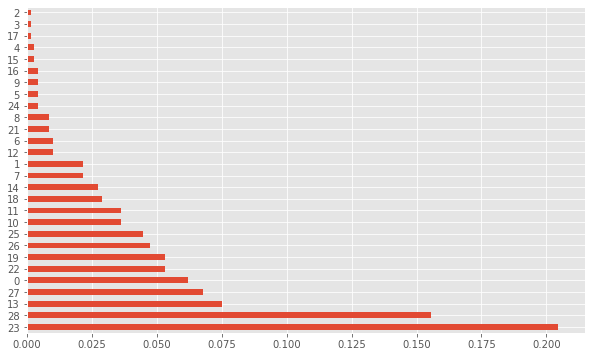

In [31]:
data['Reason for absence'].value_counts(normalize=True).plot.barh(figsize=(10, 6))

In [32]:
data['Reason for absence'].value_counts(normalize=True)

23    0.204611
28    0.155620
13    0.074928
27    0.067723
0     0.061960
22    0.053314
19    0.053314
26    0.047550
25    0.044669
10    0.036023
11    0.036023
18    0.028818
14    0.027378
7     0.021614
1     0.021614
12    0.010086
6     0.010086
21    0.008646
8     0.008646
24    0.004323
5     0.004323
9     0.004323
16    0.004323
15    0.002882
4     0.002882
17    0.001441
3     0.001441
2     0.001441
Name: Reason for absence, dtype: float64

## Частотное кодирование категориальных переменных
Полезно, когда в категории слишком много уникальных значений

In [33]:
data['Reason for absence'].value_counts(normalize=True)[:5]

23    0.204611
28    0.155620
13    0.074928
27    0.067723
0     0.061960
Name: Reason for absence, dtype: float64

In [34]:
stay = [0, 27, 13, 28, 23]

In [35]:
data['Reason for absence'] = data['Reason for absence'].apply(
    lambda x: x if x in stay else -1)

# Второй вариант  - выкидываем причину

In [36]:
data.drop(['Reason for absence'], axis=1, inplace=True)
categorical.remove('Reason for absence')

In [37]:
# data['Reason for absence'].value_counts(normalize=True).plot.bar();

In [38]:
data[categorical].head()

,Month of absence,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,7,3,1,0,1,2,1,0,1
1,7,3,1,1,1,1,1,0,0
2,7,4,1,0,1,0,1,0,0
3,7,5,1,0,1,2,1,1,0
4,7,5,1,0,1,2,1,0,1


In [39]:
categorical.remove('Month of absence')

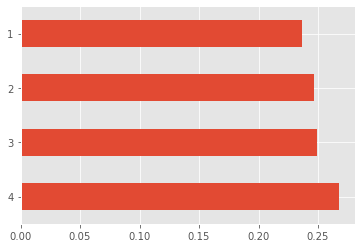

In [40]:
data['Seasons'].value_counts(normalize=True).plot.barh();

In [41]:
data[categorical].head()

,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,3,1,0,1,2,1,0,1
1,3,1,1,1,1,1,0,0
2,4,1,0,1,0,1,0,0
3,5,1,0,1,2,1,1,0
4,5,1,0,1,2,1,0,1


### Удаляем месяц отсутствия человека, оставляем сезон отсутствия

In [42]:
data.drop(['Month of absence'], axis=1, inplace=True)

In [43]:
data.shape

(694, 18)

In [44]:
pd.get_dummies(data[categorical], drop_first=True)

,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,3,1,0,1,2,1,0,1
1,3,1,1,1,1,1,0,0
2,4,1,0,1,0,1,0,0
3,5,1,0,1,2,1,1,0
4,5,1,0,1,2,1,0,1
...,...,...,...,...,...,...,...,...
735,3,1,0,1,2,1,0,1
736,3,1,0,3,1,0,0,1
737,3,1,0,1,1,1,0,8
738,4,2,0,1,2,1,0,2


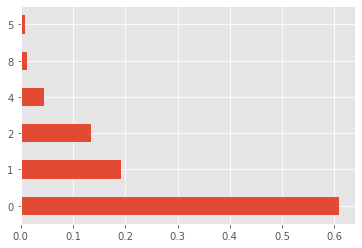

In [45]:
data['Pet'].value_counts(normalize=True).plot.barh();

In [46]:
data['Pet'] = data['Pet'].apply(lambda x: x if x in [0, 1] else 'more')

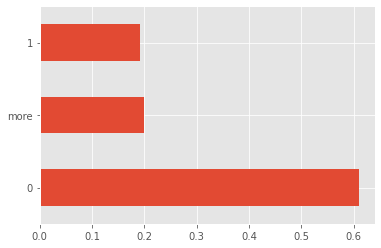

In [47]:
data['Pet'].value_counts(normalize=True).plot.barh();

In [48]:
data[categorical]

,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,3,1,0,1,2,1,0,1
1,3,1,1,1,1,1,0,0
2,4,1,0,1,0,1,0,0
3,5,1,0,1,2,1,1,0
4,5,1,0,1,2,1,0,1
...,...,...,...,...,...,...,...,...
735,3,1,0,1,2,1,0,1
736,3,1,0,3,1,0,0,1
737,3,1,0,1,1,1,0,more
738,4,2,0,1,2,1,0,more


In [49]:
data = pd.get_dummies(data, columns=categorical, drop_first=True)

In [50]:
data.shape

(694, 29)

In [51]:
data.columns

Index(['Transportation expense', 'Distance from Residence to Work',
       'Service time', 'Age', 'Work load Average/day ', 'Hit target', 'Weight',
       'Height', 'Body mass index', 'Absenteeism time in hours',
       'Day of the week_3', 'Day of the week_4', 'Day of the week_5',
       'Day of the week_6', 'Seasons_2', 'Seasons_3', 'Seasons_4',
       'Disciplinary failure_1', 'Education_2', 'Education_3', 'Education_4',
       'Son_1', 'Son_2', 'Son_3', 'Son_4', 'Social drinker_1',
       'Social smoker_1', 'Pet_1', 'Pet_more'],
      dtype='object')

# Работаем с непрерывными переменными

In [52]:
# data = data[data['Reason for absence_0'] != 1]

In [53]:
from sklearn.model_selection import train_test_split

In [54]:
#import warnings
#warnings.filterwarnings('ignore')

In [55]:
X_train, X_test, y_train, y_test = train_test_split(
    data.drop(['Absenteeism time in hours'], axis=1),
    data['Absenteeism time in hours'],
    test_size=0.3
)

In [56]:
from sklearn.preprocessing import StandardScaler

In [57]:
scaler = StandardScaler()
X_train_scaled_numeric = scaler.fit_transform(X_train[numerical])
X_test_scaled_numeric = scaler.transform(X_test[numerical])

In [58]:
X_train_scaled_numeric

array([[ 0.62880698, -0.87782064, -0.31788172, ...,  0.34900753,
        -0.94761544, -0.47824156],
       [-0.70813528, -0.4140483 , -0.93265963, ...,  0.18443663,
        -0.33133185, -0.8807014 ],
       [-1.00523357, -1.80536532, -0.24957307, ..., -0.65337887,
        -1.79500537, -0.8807014 ],
       ...,
       [ 0.18315956,  0.97726873,  1.45814333, ..., -0.65337887,
         0.74716443, -0.11871636],
       [-0.411037  , -0.4140483 , -1.20589425, ..., -1.01244266,
         1.20937713,  0.81518009],
       [ 0.48025784, -0.4140483 ,  0.09197021, ...,  1.02225214,
        -0.48540274,  0.51574859]])

In [59]:
X_train[numerical] = X_train_scaled_numeric
X_test[numerical] = X_test_scaled_numeric

In [60]:
X_train.head()

,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Weight,Height,Body mass index,Day of the week_3,...,Education_3,Education_4,Son_1,Son_2,Son_3,Son_4,Social drinker_1,Social smoker_1,Pet_1,Pet_more
449,0.349008,-0.317882,0.757347,0.628807,-0.478242,0.157771,-0.947615,-0.335246,-0.877821,1,...,0,0,0,0,0,0,1,0,0,0
676,0.184437,-0.932660,-1.078073,-0.708135,-0.880701,1.198843,-0.331332,0.983978,-0.414048,0,...,1,0,0,0,0,0,0,0,0,0
679,-0.653379,-0.249573,-0.848645,-1.005234,-0.880701,1.198843,-1.795005,-0.170343,-1.805365,0,...,1,0,0,0,0,0,0,0,0,0
397,2.323858,1.321526,-0.389790,-0.113939,-0.714518,0.938575,-1.101686,0.324366,-1.341593,1,...,0,0,0,1,0,0,0,1,0,1
454,-1.565999,-1.137586,1.216203,1.965749,-0.478242,0.157771,1.440483,0.983978,0.977269,0,...,0,0,1,0,0,0,1,0,0,0


In [61]:
from sklearn import metrics
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [62]:
def dataframe_metrics(y_test, y_pred):
    stats = [
        metrics.mean_absolute_error(np.exp(y_test)-1, np.exp(y_pred)-1),
        np.sqrt(metrics.mean_squared_error(np.exp(y_test)-1, np.exp(y_pred)-1)),
        metrics.r2_score(np.exp(y_test), np.exp(y_pred)-1),
        mean_absolute_percentage_error(np.exp(y_test), np.exp(y_pred))
    ]
    return stats
measured_metrics = pd.DataFrame({'error_type':['MAE', 'RMSE', 'R2', 'MAPE']})
measured_metrics.set_index('error_type')

""
error_type
MAE
RMSE
R2
MAPE


In [63]:
y_mean = np.mean(y_train)                     # посчитали среднее 
y_pred_naive = np.ones(len(y_test)) * y_mean  # спрогнозировали им цену всех квартир в тестовой выборке
y_pred_naive[:5]

array([1.56567928, 1.56567928, 1.56567928, 1.56567928, 1.56567928])

In [64]:
measured_metrics['naive'] = dataframe_metrics(y_test, y_pred_naive)
measured_metrics

,error_type,naive
0,MAE,3.770686
1,RMSE,6.977854
2,R2,-0.158822
3,MAPE,76.479036


(array([ 29.,  61.,  99., 107.,   5., 145.,   0.,  29.,   4.,   6.]),
 array([0.        , 0.40430513, 0.80861025, 1.21291538, 1.61722051,
        2.02152563, 2.42583076, 2.83013589, 3.23444101, 3.63874614,
        4.04305127]),
 <BarContainer object of 10 artists>)

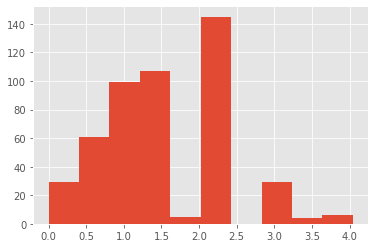

In [65]:
plt.hist(y_train)

In [66]:
from sklearn.linear_model import LinearRegression

# Объявили модель
model_regression = LinearRegression()

# Обучили модель на тренировочной выборке 
model_regression.fit(X_train, y_train)

# Сделали прогнозы на тестовой выборке 
y_pred_regr = model_regression.predict(X_test)

In [67]:
measured_metrics['simple_linreg'] = dataframe_metrics(y_test, y_pred_regr)
measured_metrics

,error_type,naive,simple_linreg
0,MAE,3.770686,3.286172
1,RMSE,6.977854,6.591070
2,R2,-0.158822,-0.022229
3,MAPE,76.479036,54.406372


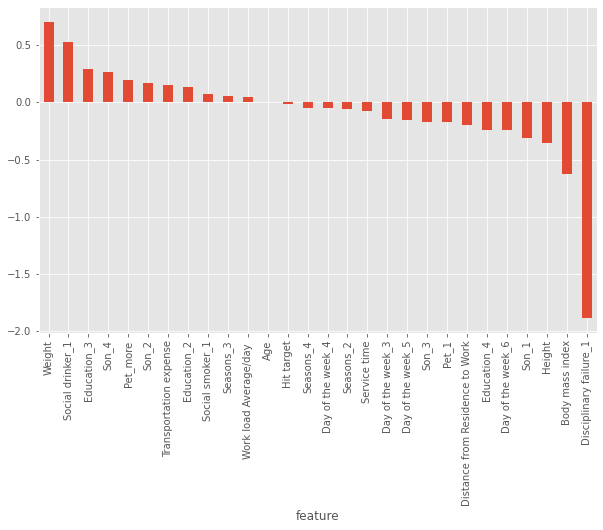

In [68]:
featureImportance = pd.DataFrame({"feature": data.drop(target,axis=1).columns, 
                                  "importance": model_regression.coef_})

featureImportance.set_index('feature', inplace=True)
featureImportance.sort_values(["importance"], ascending=False, inplace=True)
featureImportance["importance"].plot(kind='bar', figsize=(10, 6));

Лучшее значение параметра: 0.00515881240008121


,error_type,naive,simple_linreg,lasso_cv
0,MAE,3.770686,3.286172,3.298950
1,RMSE,6.977854,6.591070,6.576611
2,R2,-0.158822,-0.022229,-0.024233
3,MAPE,76.479036,54.406372,53.601121


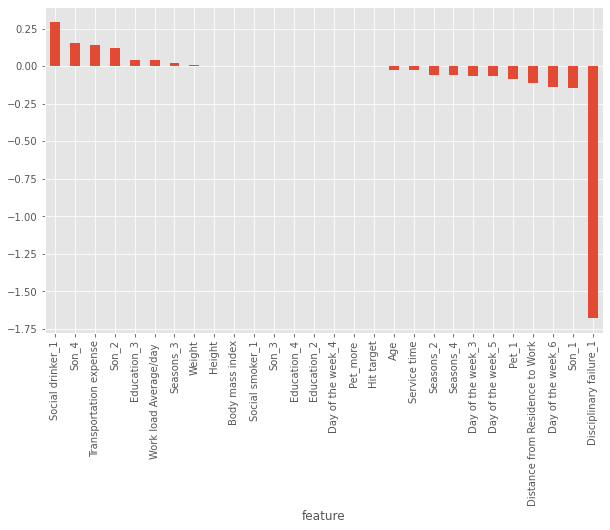

In [69]:
from sklearn.linear_model import LassoCV

# Объявили модель
lasso_cv = LassoCV(cv=5)


# Обучили модель на тренировочной выборке 
lasso_cv.fit(X_train, y_train)
print('Лучшее значение параметра:', lasso_cv.alpha_)

# Сделали прогнозы на тестовой выборке 
y_pred_lasso = lasso_cv.predict(X_test)

featureImportance = pd.DataFrame({"feature": data.drop(target,axis=1).columns, 
                                  "importance": lasso_cv.coef_})

featureImportance.set_index('feature', inplace=True)
featureImportance.sort_values(["importance"], ascending=False, inplace=True)
featureImportance["importance"].plot(kind='bar', figsize=(10, 6));

measured_metrics['lasso_cv'] = dataframe_metrics(y_test, y_pred_lasso)
measured_metrics

,error_type,naive,simple_linreg,lasso_cv,elastic_cv
0,MAE,3.770686,3.286172,3.298950,3.298950
1,RMSE,6.977854,6.591070,6.576611,6.576611
2,R2,-0.158822,-0.022229,-0.024233,-0.024233
3,MAPE,76.479036,54.406372,53.601121,53.601121


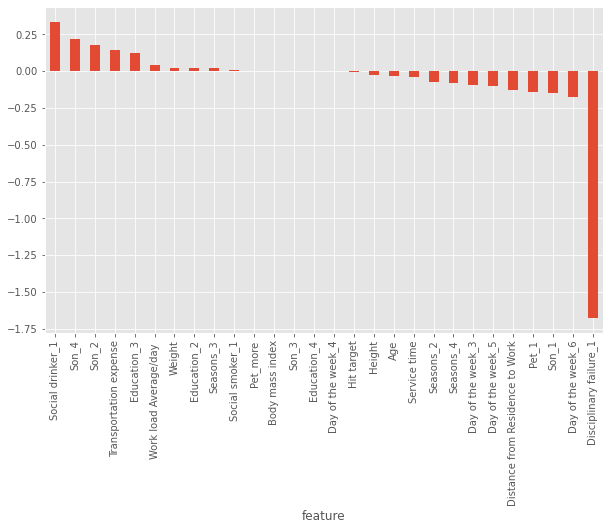

In [70]:
from sklearn.linear_model import ElasticNetCV

# Объявили модель
elastic_cv = ElasticNetCV(cv=5)


# Обучили модель на тренировочной выборке 
elastic_cv.fit(X_train, y_train)

# Сделали прогнозы на тестовой выборке 
y_pred_elastic = lasso_cv.predict(X_test)

featureImportance = pd.DataFrame({"feature": data.drop(target,axis=1).columns, 
                                  "importance": elastic_cv.coef_})

featureImportance.set_index('feature', inplace=True)
featureImportance.sort_values(["importance"], ascending=False, inplace=True)
featureImportance["importance"].plot(kind='bar', figsize=(10, 6));

measured_metrics['elastic_cv'] = dataframe_metrics(y_test, y_pred_elastic)
measured_metrics